In [127]:
import os, sys
sys.path.append("C:/Users/piyalong/CrowdCounting-P2PNet/")

import argparse
import datetime
import random
import time
from pathlib import Path

import torch
import torchvision.transforms as standard_transforms
import numpy as np

from PIL import Image
import cv2
from crowd_datasets import build_dataset
from engine import *
from models import build_model

import warnings
warnings.filterwarnings('ignore')

from matplotlib import pyplot as plt
%matplotlib inline
torch.cuda.empty_cache() 
import json
from matplotlib.patches import Circle
import pandas as pd



# Test model

11


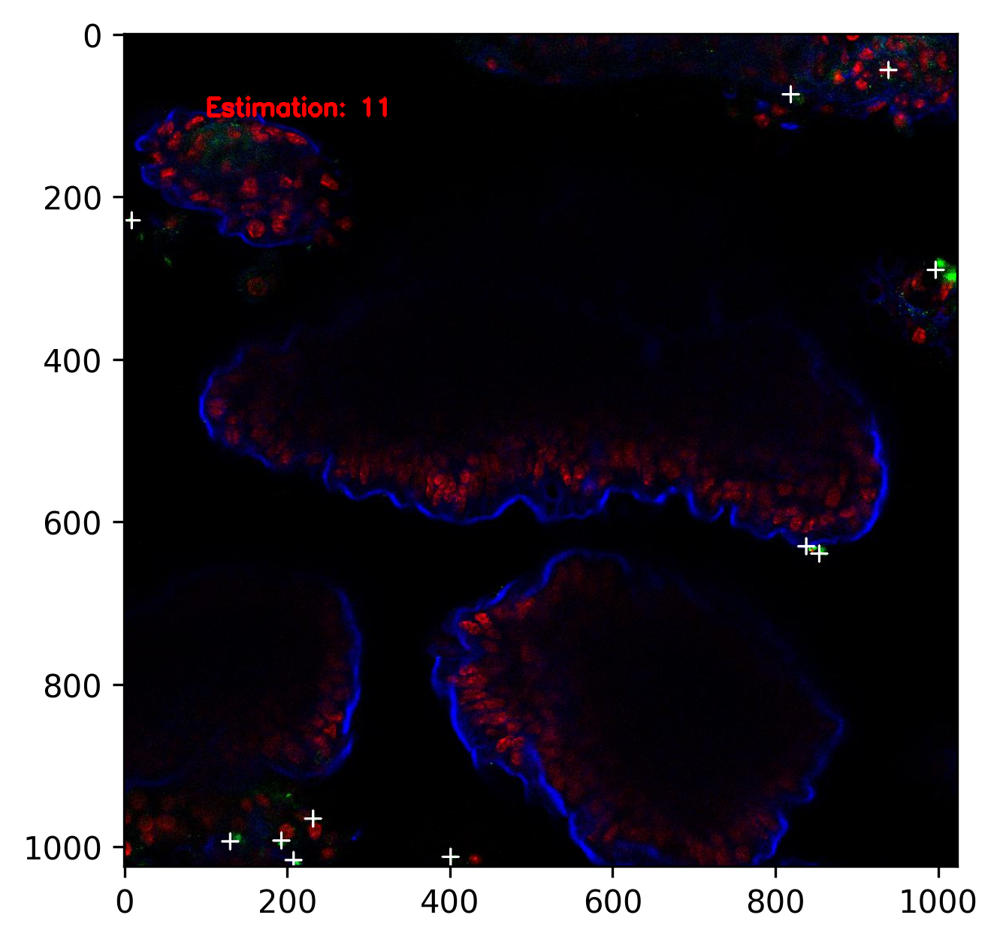

In [128]:
class Args():
    backbone='vgg16_bn'
    gpu_id=0
    img_path='D:/20230426CDI/data/test/WT-1_ID_PIC-1_JOA100_2.jpg'
    line=2
    output_dir='output'
    row=2
    weight_path='C:/Users/piyalong/PointTracking/20230506/ckpts/best_mae.pth'

args=Args()

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
torch. set_grad_enabled(False)
# def main(args, debug=False):

#     os.environ["CUDA_VISIBLE_DEVICES"] = '{}'.format(args.gpu_id)

print(args)
# device = torch.device('cpu')
# get the P2PNet
model = build_model(args)
# move to GPU
model.to(device)
# load trained model
if args.weight_path is not None:
    checkpoint = torch.load(args.weight_path, map_location=device)
    model.load_state_dict(checkpoint['model'])
# convert to eval mode
model.eval()
# create the pre-processing transform
transform = standard_transforms.Compose([
    standard_transforms.ToTensor(), 
    standard_transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# set your image path here
img_path = args.img_path
# load the images
img_raw = Image.open(img_path).convert('RGB')
# round the size
# width, height = img_raw.size
# new_width = width // 128 * 128
# new_height = height // 128 * 128
# img_raw = img_raw.resize((new_width, new_height), Image.ANTIALIAS)
# pre-proccessing
img = transform(img_raw)

samples = torch.Tensor(img).unsqueeze(0)
samples = samples.to(device)
# run inference
outputs = model(samples)
outputs_scores = torch.nn.functional.softmax(outputs['pred_logits'], -1)[:, :, 1][0]

outputs_points = outputs['pred_points'][0]

threshold = 0.9
# filter the predictions
points = outputs_points[outputs_scores > threshold].detach().cpu().numpy().tolist()
predict_cnt = int((outputs_scores > threshold).sum())
scores= outputs_scores[outputs_scores > threshold]
outputs_scores = torch.nn.functional.softmax(outputs['pred_logits'], -1)[:, :, 1][0]

outputs_points = outputs['pred_points'][0]
# draw the predictions
size = 4
img_to_draw = cv2.cvtColor(np.array(img_raw), cv2.COLOR_RGB2BGR)

img_to_draw = cv2.putText(img_to_draw,"Estimation: "+str(len(points)), (100,100), cv2.FONT_HERSHEY_SIMPLEX,1, (0,0,255), 3)
print(len(points))
for p in points:
    # img_to_draw = cv2.circle(img_to_draw, (int(p[0]), int(p[1])), size, (0, 0, 255), -1)
    cv2.drawMarker(img_to_draw, (int(p[0]), int(p[1])), (255, 255, 255), cv2.MARKER_CROSS, markerSize=20,thickness=2)
    
# cv2.rectangle(img_to_draw, (100, 100), (120, 140), (255,255,255), 2)
# save the visualized image
# cv2.imshow('ImageWindow',img_to_draw)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

cv2.imwrite(os.path.join(args.output_dir, 'pred{}.jpg'.format(predict_cnt)), img_to_draw)

img_to_draw = cv2.cvtColor(img_to_draw, cv2.COLOR_BGR2RGB)

fig, ax = plt.subplots(dpi=300)

plt.imshow(img_to_draw)

# Prediction Function

In [129]:
    
def predict(img_path,    threshold = 0.05):

    img_raw = Image.open(img_path).convert('RGB')

    img = transform(img_raw)

    samples = torch.Tensor(img).unsqueeze(0)
    samples = samples.to(device)
    # run inference
    outputs = model(samples)
    outputs_scores = torch.nn.functional.softmax(outputs['pred_logits'], -1)[:, :, 1][0]

    outputs_points = outputs['pred_points'][0]

    # filter the predictions
    points = outputs_points[outputs_scores > threshold].detach().cpu().numpy().tolist()
    predict_cnt = int((outputs_scores > threshold).sum())
    scores= outputs_scores[outputs_scores > threshold]
    outputs_scores = torch.nn.functional.softmax(outputs['pred_logits'], -1)[:, :, 1][0]

    predicted_points=np.array(points).astype(int)
    return predicted_points

In [130]:
predicted_points=predict(img_path,    threshold = 0.05)

In [131]:
predicted_points

array([[ 871,    1],
       [ 939,   44],
       [ 929,   51],
       [ 916,   68],
       [ 819,   74],
       [ 822,   77],
       [   9,  229],
       [  54,  273],
       [  54,  274],
       [  59,  286],
       [  56,  280],
       [  49,  280],
       [ 997,  290],
       [1021,  299],
       [1020,  340],
       [1022,  338],
       [ 192,  563],
       [ 838,  630],
       [ 854,  639],
       [ 232,  965],
       [ 130,  993],
       [ 193,  992],
       [ 401, 1012],
       [  19, 1019],
       [  16, 1023],
       [ 208, 1016]])

In [132]:
txt_file = img_path[:-4]+".txt"


# Get GT

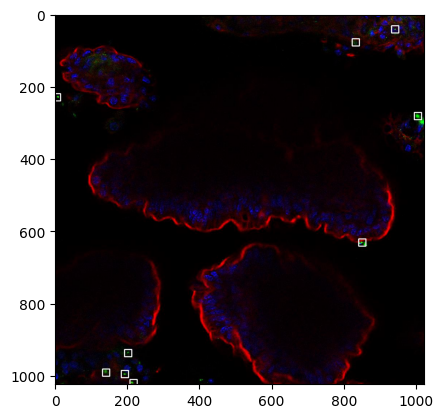

In [133]:
import re
img_raw = Image.open(img_path).convert('RGB')
img_to_draw = cv2.cvtColor(np.array(img_raw), cv2.COLOR_RGB2BGR)

ground_truth_pixel_points=[]
with open(txt_file) as file:
    for pt in file.readlines():
        x,y=pt.split(" ")
        numbersx = re.findall('\d+', x)[0]
        numbersy = re.findall('\d+', y)[0]
        # print(int(numbersx),int(numbersy))
        ground_truth_pixel_points.append([int(numbersx),int(numbersy)])
        cv2.drawMarker(img_to_draw, (int(numbersx),int(numbersy)), (255, 255, 255), cv2.MARKER_SQUARE, markerSize=20,thickness=2)
plt.imshow(img_to_draw)

# Get GT function

In [134]:
import re
def get_gt(txt_file):

    ground_truth_pixel_points=[]
    with open(txt_file) as file:
        for pt in file.readlines():
            x,y=pt.split(" ")
            numbersx = re.findall('\d+', x)[0]
            numbersy = re.findall('\d+', y)[0]
            ground_truth_pixel_points.append([int(numbersx),int(numbersy)])

    return ground_truth_pixel_points



In [135]:
gt_points=get_gt(txt_file)
gt_points

[[5, 230],
 [141, 992],
 [193, 996],
 [217, 1021],
 [202, 938],
 [850, 632],
 [1004, 282],
 [832, 78],
 [941, 42]]

In [136]:
from scipy.optimize import linear_sum_assignment
import numpy as np
from scipy.spatial.distance import cdist

3 3 3


Text(0.5, 1.0, 'Recall: 100.00% Precision: 100.00%')

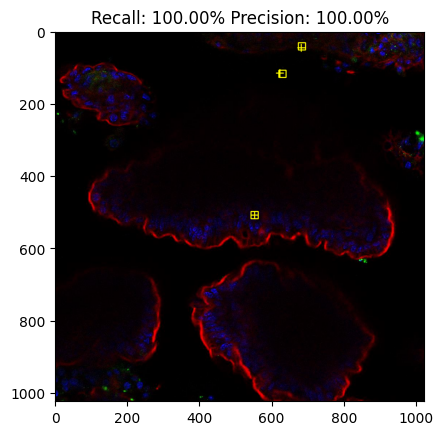

In [182]:

image = cv2.cvtColor(np.array(img_raw), cv2.COLOR_RGB2BGR)


cost_matrix=cdist(predicted_points, gt_points, 'euclidean')
square_size=20
tp=0
a=20

row_indices, col_indices = linear_sum_assignment(cost_matrix)

src_points=[]
target_points=[]

n_points_pred = len(predicted_points)
n_points_gt = len(gt_points)

        
for row, col in zip(row_indices, col_indices):
    if row < n_points_pred and col < n_points_gt:
        pred_point = predicted_points[row]
        gt_point = gt_points[col]
        if cost_matrix[row, col]<a:
            # print(pred_point)
            cv2.drawMarker(image, (gt_point), (255, 255, 0), cv2.MARKER_SQUARE, markerSize=square_size,thickness=2)
            cv2.drawMarker(image, (pred_point), (255, 255, 0), cv2.MARKER_CROSS, markerSize=square_size,thickness=2)
            tp+=1
        else:
            cv2.drawMarker(image, (gt_point), (255, 255, 255), cv2.MARKER_SQUARE, markerSize=square_size,thickness=2)
            cv2.drawMarker(image, (pred_point), (255, 255, 255), cv2.MARKER_CROSS, markerSize=square_size,thickness=2)

        # print(f"Predicted point {row} ({pred_point}) is assigned to ground truth point {col} ({gt_point}) with cost {cost_matrix[row, col]}")
    elif row < n_points_pred:
        pred_point = predicted_points[row]
        # print(f"Predicted point {row} ({pred_point}) is not assigned to any ground truth point")
        cv2.drawMarker(image, (pred_point), (255, 255, 255), cv2.MARKER_CROSS, markerSize=square_size,thickness=2)
    else:
        gt_point = gt_points[col]
        # print(f"Ground truth point {col} ({gt_point}) is not assigned to any predicted point")
        cv2.drawMarker(image, (gt_point), (255, 255, 255), cv2.MARKER_SQUARE, markerSize=square_size,thickness=2)
plt.imshow(image)
print(tp,n_points_gt,n_points_pred)
plt.title('Recall: {0:.2%} Precision: {1:.2%}'.format(tp/n_points_gt,tp/n_points_pred))

In [69]:
target_points

[array([941,  42]),
 array([832,  78]),
 array([  5, 230]),
 array([1004,  282]),
 array([850, 632]),
 array([202, 938]),
 array([141, 992]),
 array([193, 996]),
 array([ 217, 1021])]

In [70]:
src_points

[array([939,  44]),
 array([819,  74]),
 array([  9, 229]),
 array([997, 290]),
 array([854, 639]),
 array([232, 965]),
 array([130, 993]),
 array([193, 992]),
 array([ 208, 1016])]

# Evalutation Function

In [190]:
def evaluate(img_path,predicted_points, gt_points):
    
    img_raw = Image.open(img_path).convert('RGB')
    image = cv2.cvtColor(np.array(img_raw), cv2.COLOR_RGB2BGR)
    
    cost_matrix=cdist(predicted_points, gt_points, 'euclidean')
    square_size=20
    tp=0
    a=20
    row_indices, col_indices = linear_sum_assignment(cost_matrix)

    src_points=[]
    target_points=[]

    n_points_pred = len(predicted_points)
    n_points_gt = len(gt_points)

    for row, col in zip(row_indices, col_indices):
        if row < n_points_pred and col < n_points_gt:
            pred_point = predicted_points[row]
            gt_point = gt_points[col]
            if cost_matrix[row, col]<a:
                # print(pred_point)
                cv2.drawMarker(image, (gt_point), (255, 255, 0), cv2.MARKER_SQUARE, markerSize=square_size,thickness=2)
                cv2.drawMarker(image, (pred_point), (255, 255, 0), cv2.MARKER_CROSS, markerSize=square_size,thickness=2)
                tp+=1
            else:
                cv2.drawMarker(image, (gt_point), (255, 255, 255), cv2.MARKER_SQUARE, markerSize=square_size,thickness=2)
                cv2.drawMarker(image, (pred_point), (255, 255, 255), cv2.MARKER_CROSS, markerSize=square_size,thickness=2)

            # print(f"Predicted point {row} ({pred_point}) is assigned to ground truth point {col} ({gt_point}) with cost {cost_matrix[row, col]}")
        elif row < n_points_pred:
            pred_point = predicted_points[row]
            # print(f"Predicted point {row} ({pred_point}) is not assigned to any ground truth point")
            cv2.drawMarker(image, (pred_point), (255, 255, 255), cv2.MARKER_CROSS, markerSize=square_size,thickness=2)
        else:
            gt_point = gt_points[col]
            # print(f"Ground truth point {col} ({gt_point}) is not assigned to any predicted point")
            cv2.drawMarker(image, (gt_point), (255, 255, 255), cv2.MARKER_SQUARE, markerSize=square_size,thickness=2)
        
#     fig, ax = plt.subplots(dpi=300)

#     plt.imshow(image)

    return tp,n_points_gt,n_points_pred

(3, 3, 3)

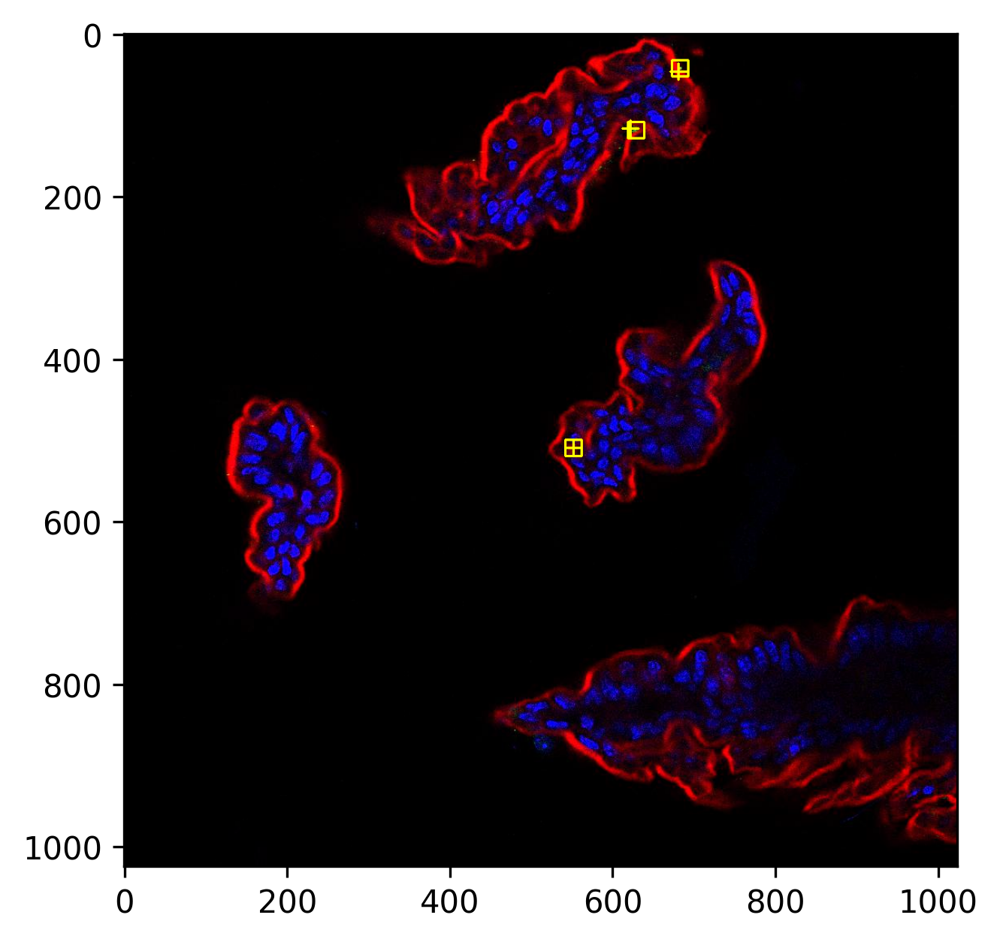

In [184]:
tp,n_points_gt,n_points_pred=evaluate(img_path,predicted_points, gt_points)
tp,n_points_gt,n_points_pred

In [185]:
a

20

# Process all data

Recall: 75.65% Precision: 75.65%


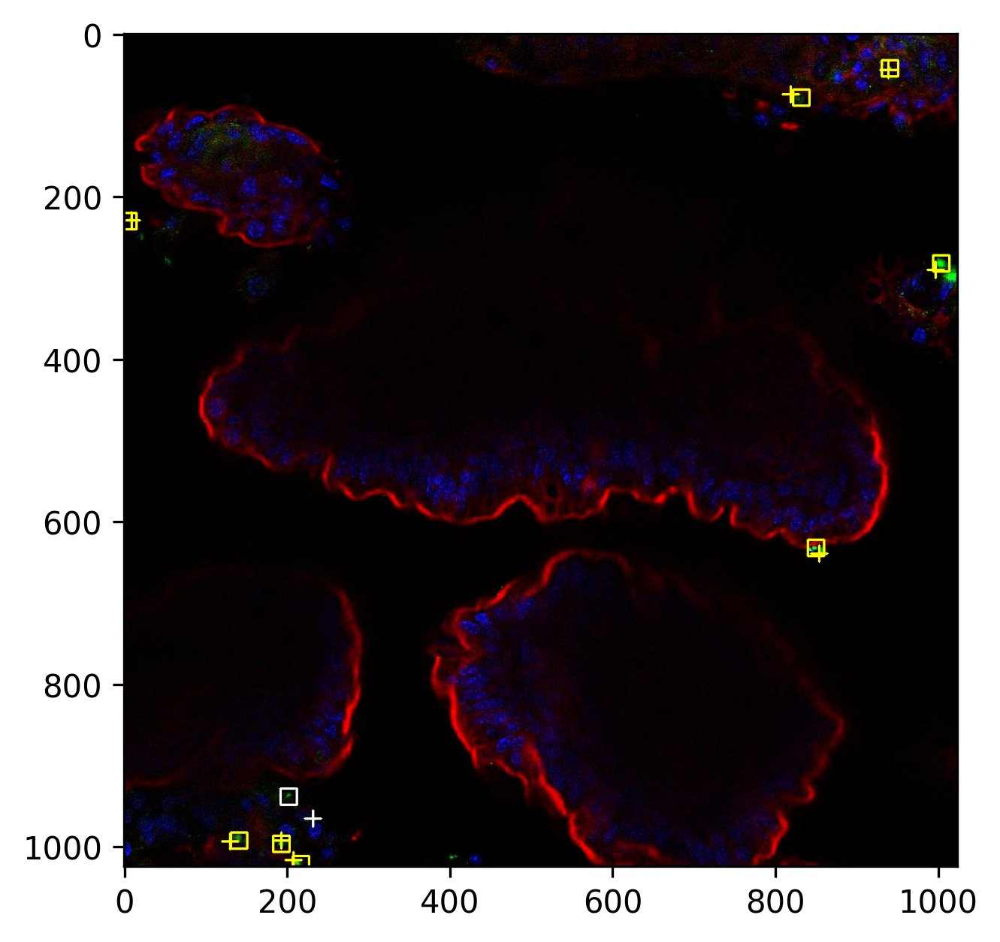

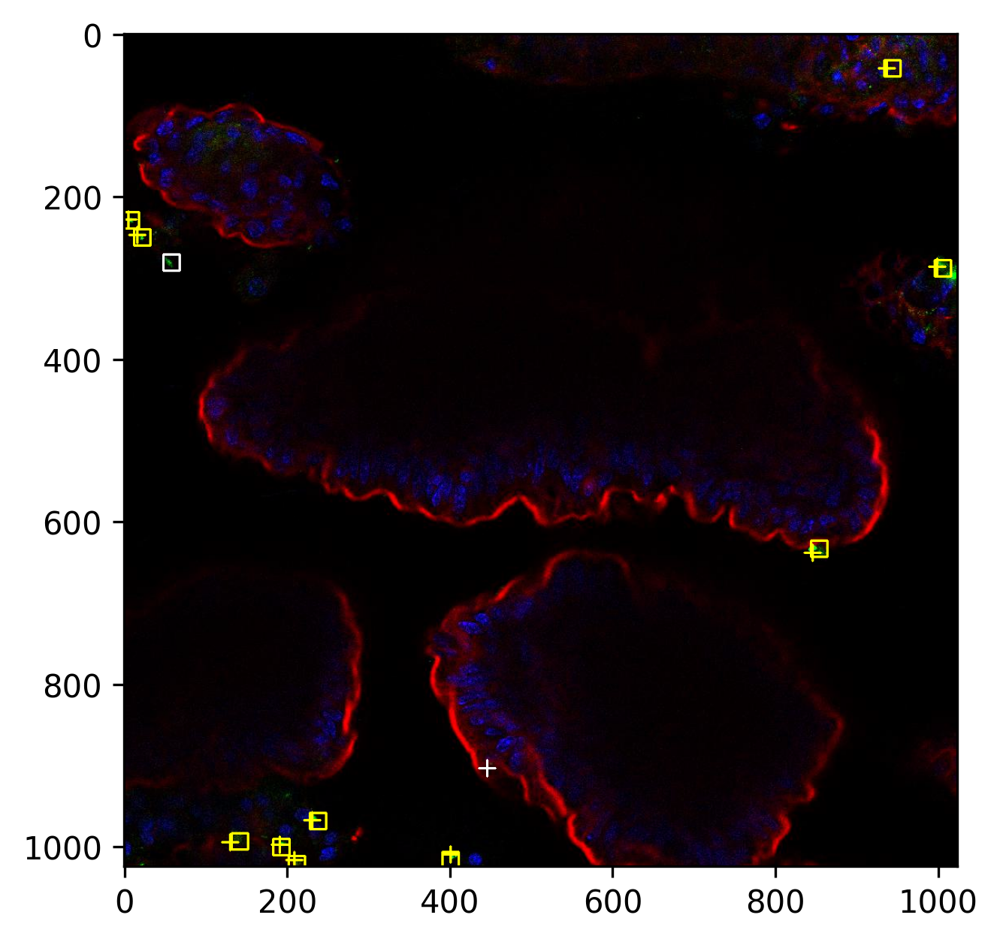

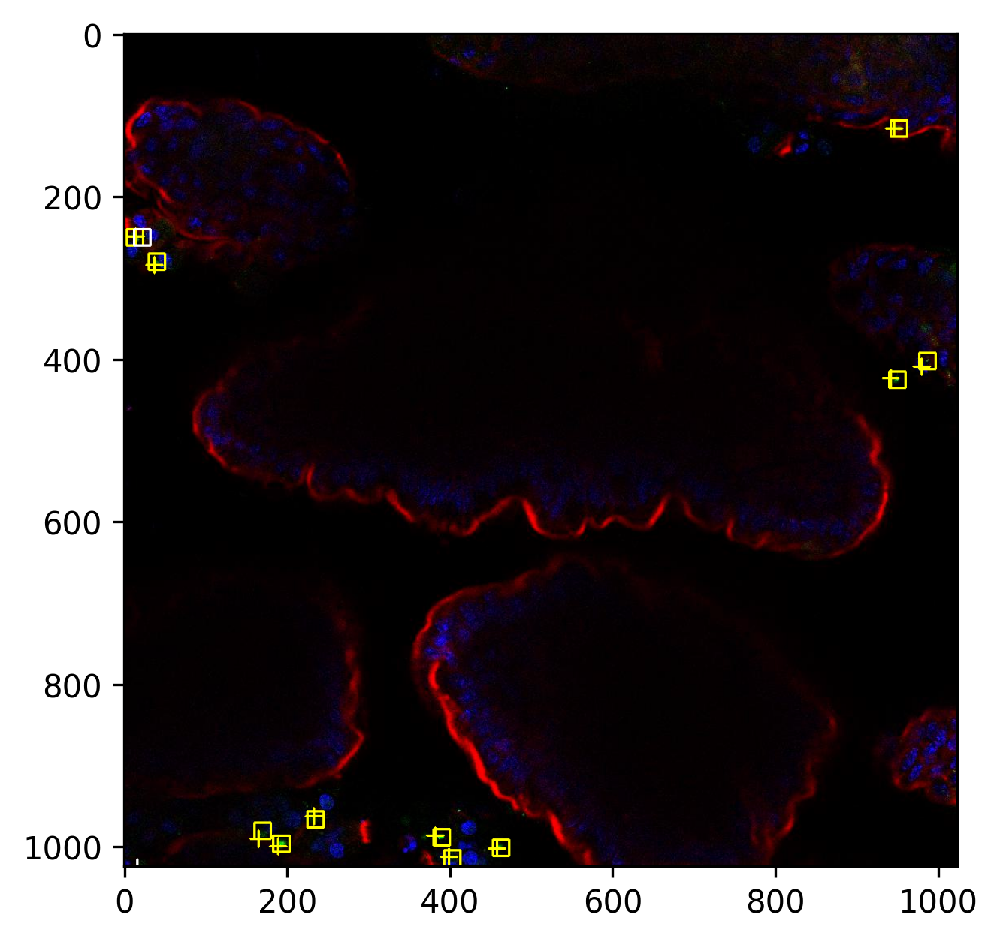

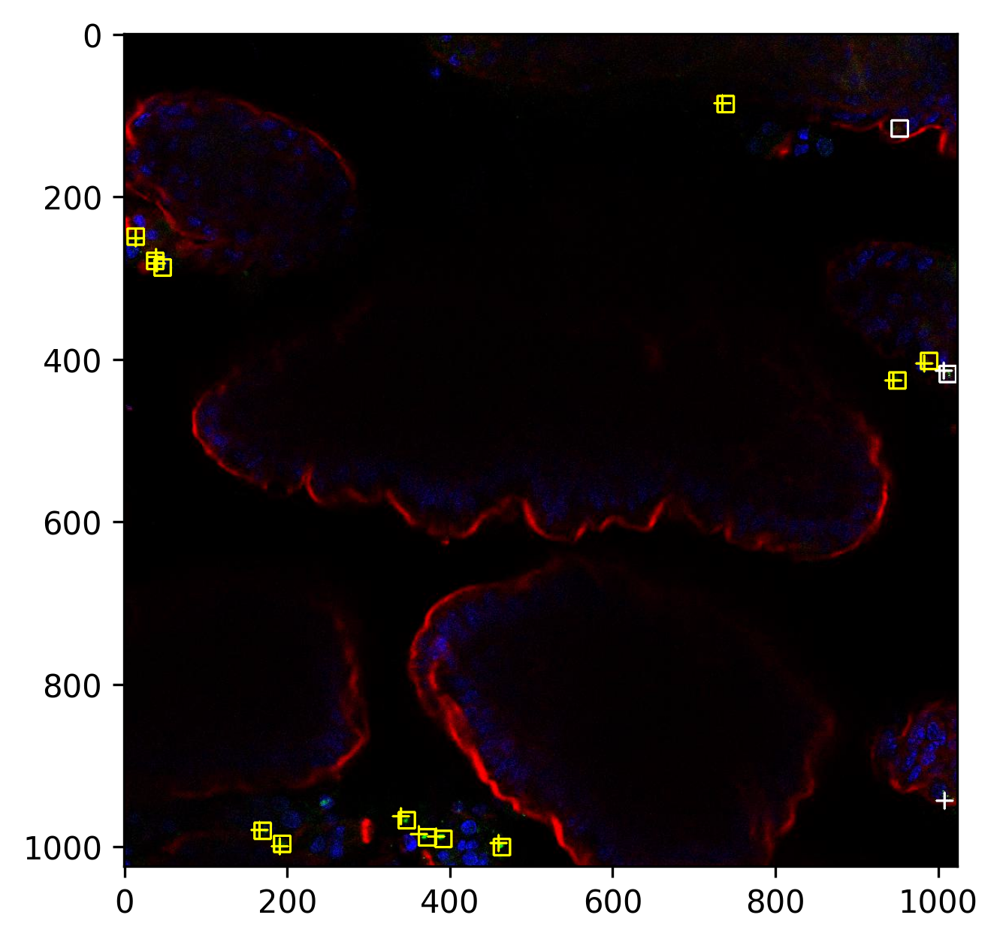

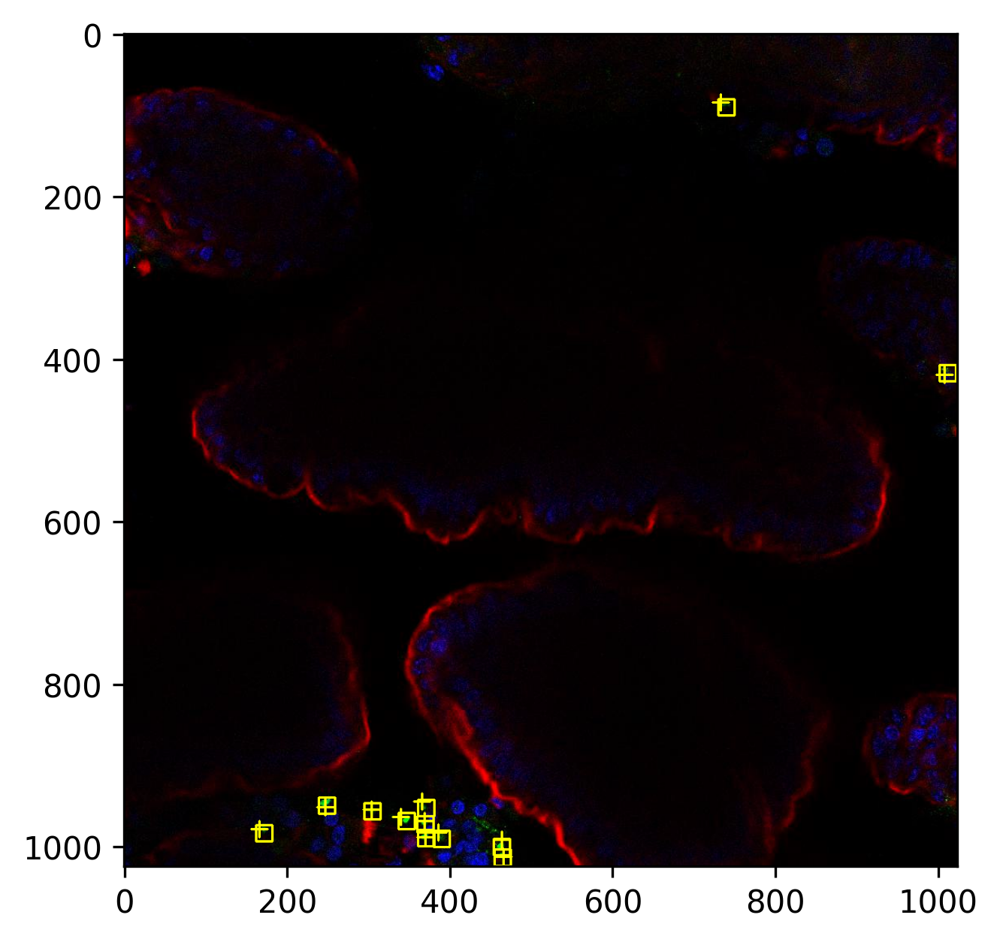

...

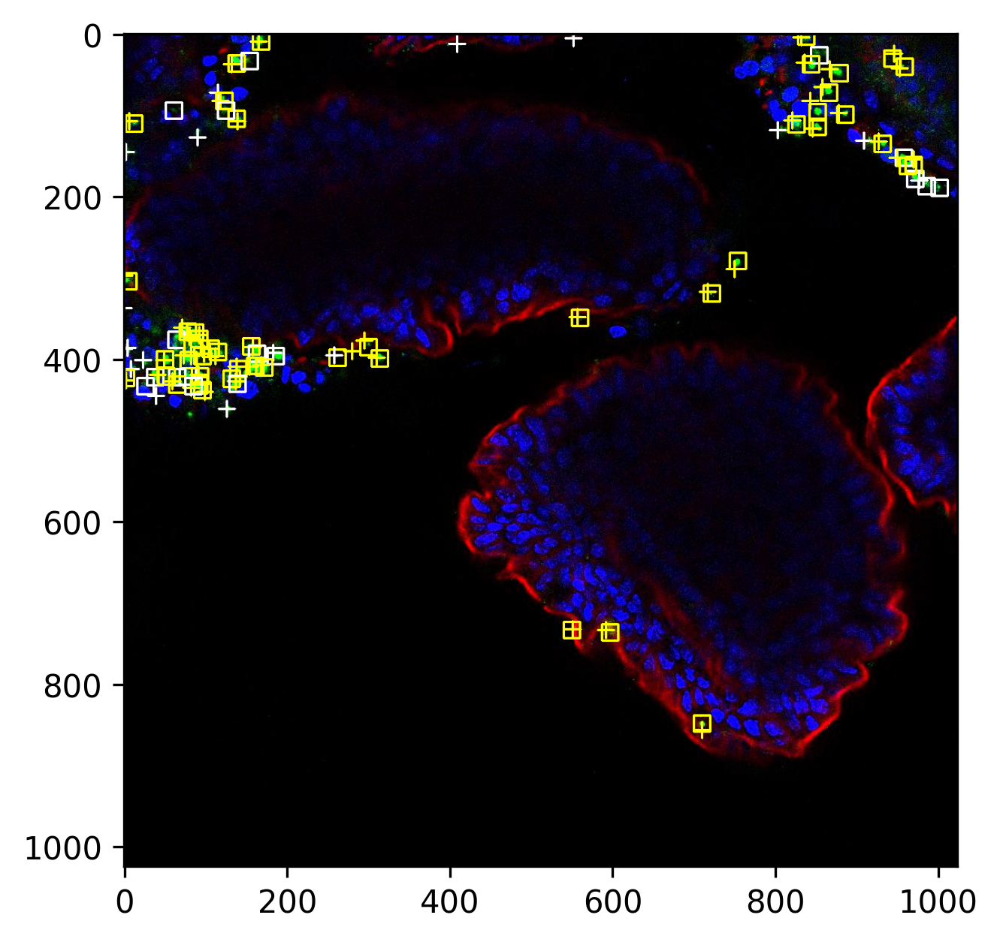

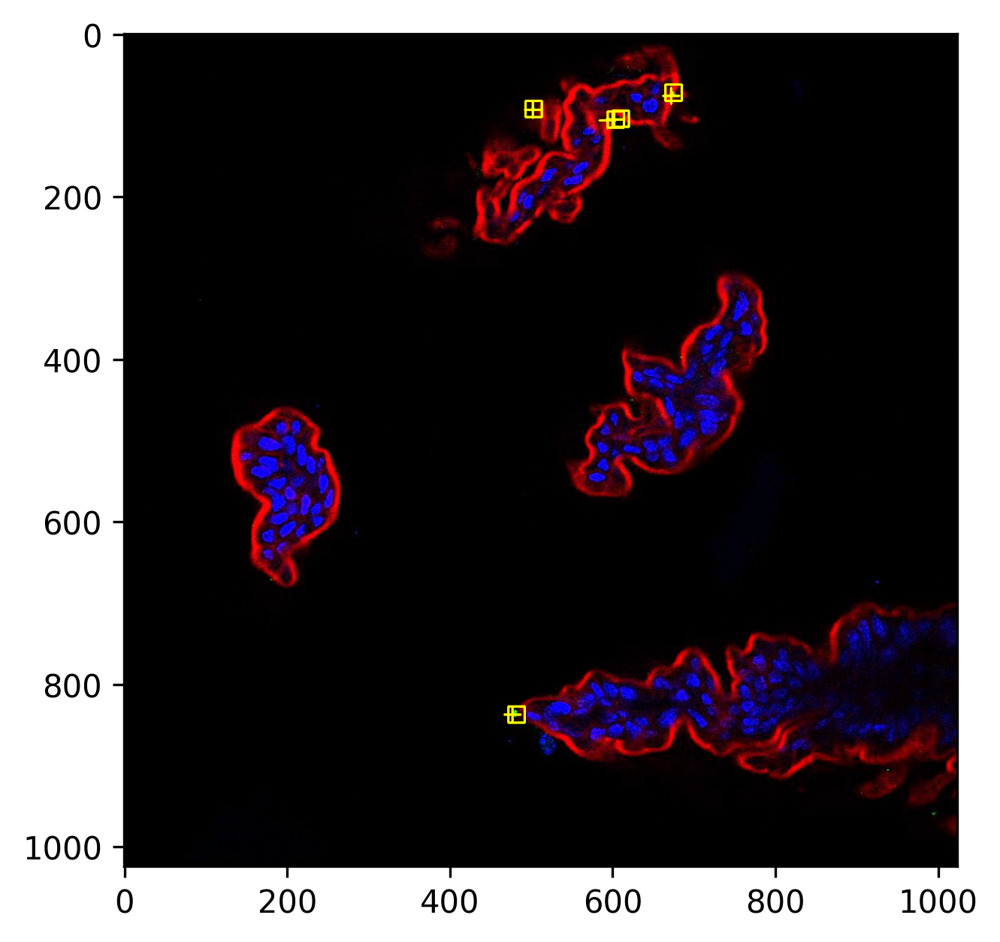

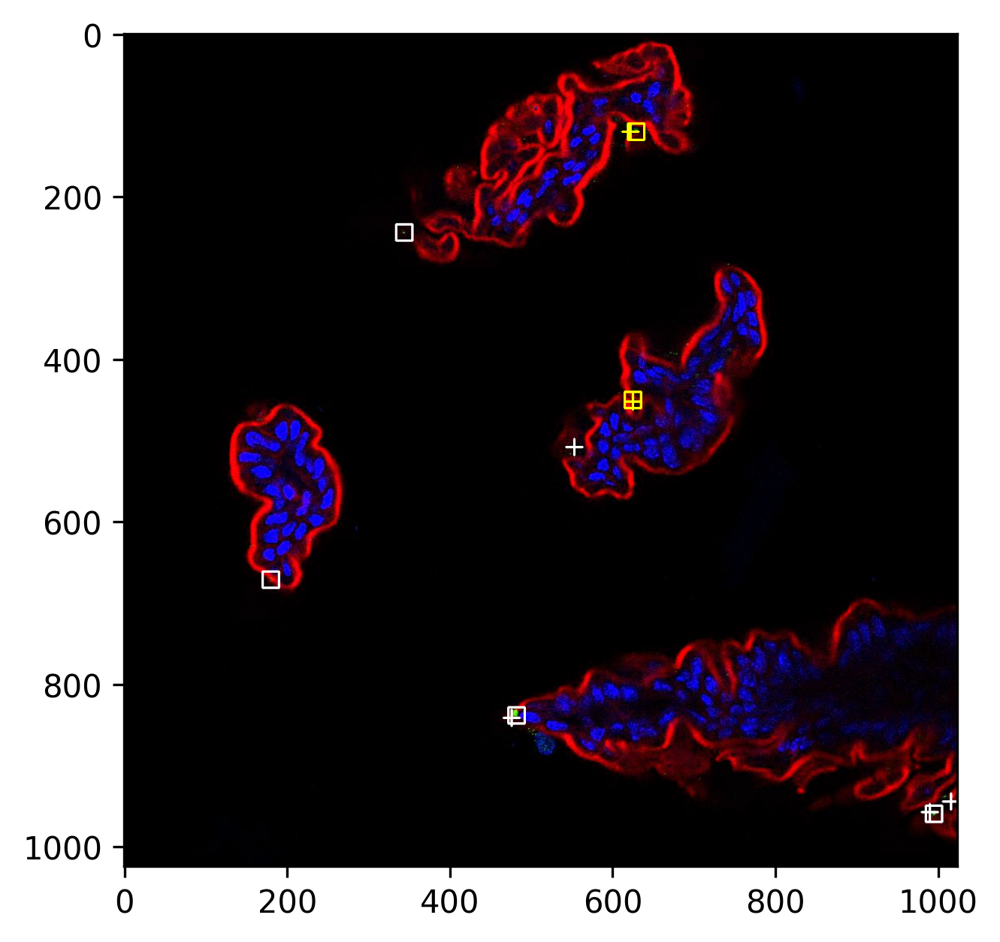

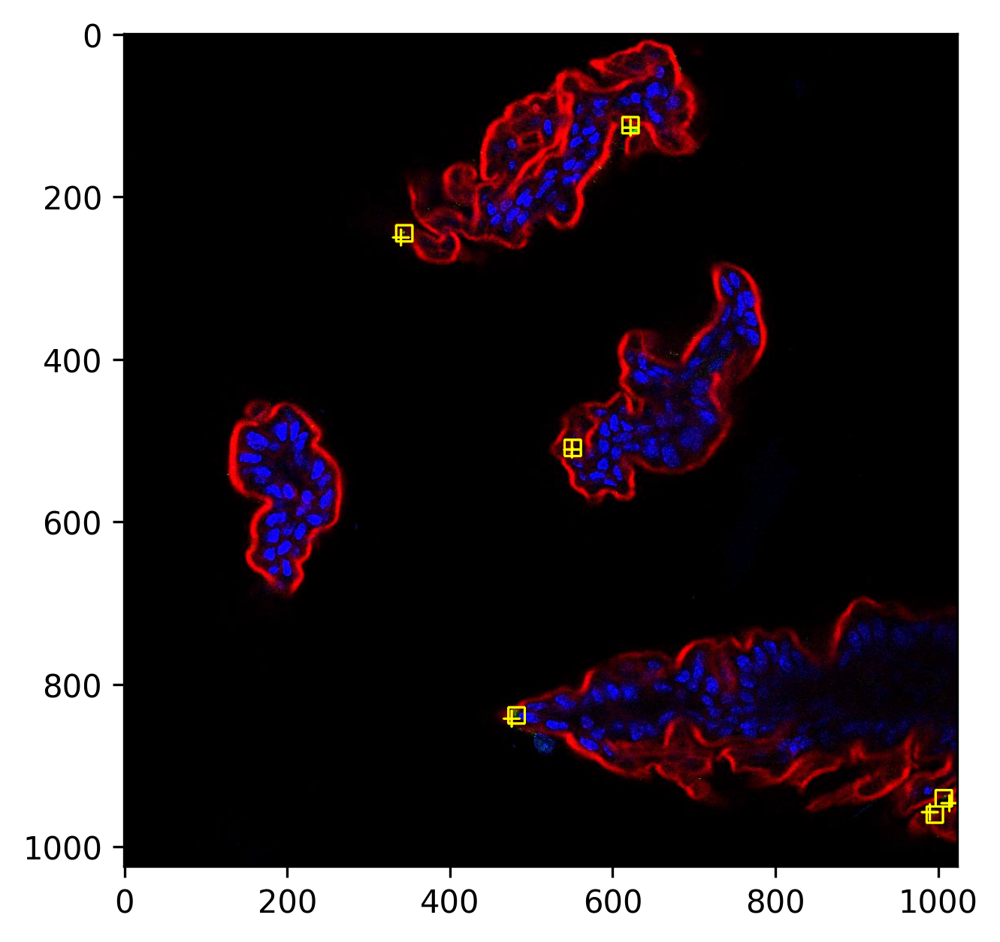

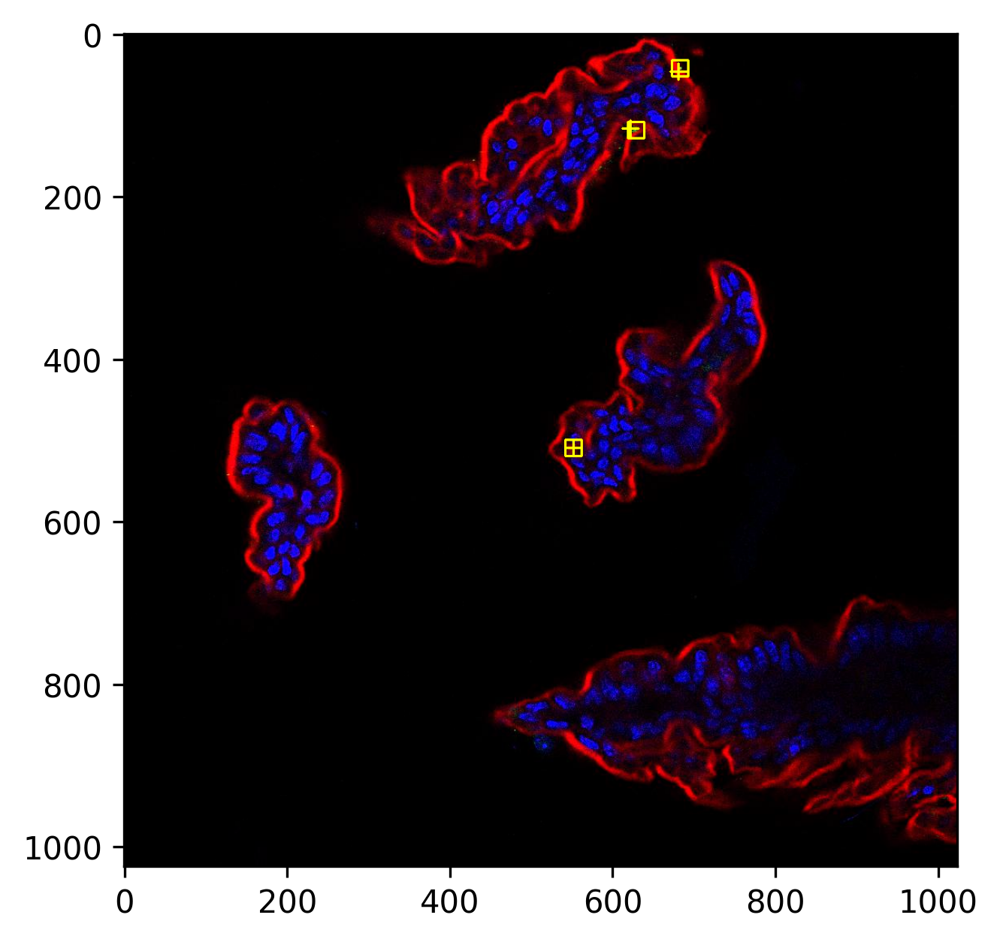

In [186]:
results={'TP':[],'GT':[],'Prediction':[]}
folder="D:/20230426CDI/data/test/"
for image_path in os.listdir(folder):
    if image_path.endswith('jpg'):
        img_path = os.path.join(folder,image_path)

        txt_file = img_path[:-4]+".txt"
        
        predicted_points=predict(img_path,    threshold = 0.45)
        gt_points=get_gt(txt_file)

        tp,n_points_gt,n_points_pred=evaluate(img_path,predicted_points, gt_points)
        
        results['TP'].append(tp)
        results['GT'].append(n_points_gt)
        results['Prediction'].append(n_points_pred)
        
sum_result = pd.DataFrame(results).sum(axis=0)
# sensitivity.append([threshold,sum_result[0]/sum_result[1],sum_result[0]/sum_result[2]])
recall,precision = sum_result['TP']/sum_result['GT'],sum_result['TP']/sum_result['Prediction']
print('Recall: {0:.2%} Precision: {1:.2%}'.format(recall,precision))

In [187]:
pd.DataFrame(results).sum(axis=0)

TP            379
GT            501
Prediction    501
dtype: int64

In [188]:
recall,precision 

(0.7564870259481038, 0.7564870259481038)

In [193]:
sensitivity=[]
for threshold in np.arange(0.01, 1, 0.1):
    results={'TP':[],'GT':[],'Prediction':[]}
    folder="D:/20230426CDI/data/test/"
    for image_path in os.listdir(folder):
        if image_path.endswith('jpg'):
            img_path = os.path.join(folder,image_path)

            txt_file = img_path[:-4]+".txt"

            predicted_points=predict(img_path,    threshold = threshold)
            gt_points=get_gt(txt_file)

            tp,n_points_gt,n_points_pred=evaluate(img_path,predicted_points, gt_points)

            results['TP'].append(tp)
            results['GT'].append(n_points_gt)
            results['Prediction'].append(n_points_pred)

    sum_result = pd.DataFrame(results).sum(axis=0)
    # sensitivity.append([threshold,sum_result[0]/sum_result[1],sum_result[0]/sum_result[2]])
    recall,precision = sum_result['TP']/sum_result['GT'],sum_result['TP']/sum_result['Prediction']
    
    sensitivity.append([threshold,recall,precision])
    
    print('Threhold: {} Recall: {:.2%} Precision: {:.2%}'.format(threshold,recall,precision))

Threhold: 0.01 Recall: 96.21% Precision: 21.13%
Threhold: 0.11 Recall: 86.83% Precision: 61.70%
Threhold: 0.21000000000000002 Recall: 83.63% Precision: 70.18%
Threhold: 0.31000000000000005 Recall: 80.84% Precision: 73.91%
Threhold: 0.41000000000000003 Recall: 76.45% Precision: 74.80%
Threhold: 0.51 Recall: 74.45% Precision: 75.97%
Threhold: 0.6100000000000001 Recall: 74.05% Precision: 78.60%
Threhold: 0.7100000000000001 Recall: 69.66% Precision: 78.60%
Threhold: 0.81 Recall: 65.47% Precision: 79.04%
Threhold: 0.91 Recall: 62.28% Precision: 81.89%


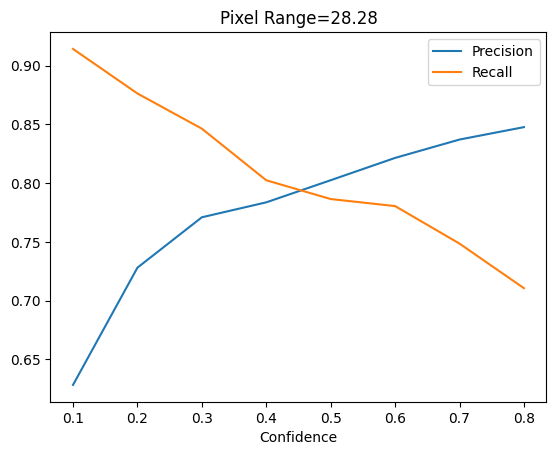

In [160]:
df=pd.DataFrame(sensitivity)
df.columns = ['Thredhold', 'Recall', 'Precision']
plt.plot(df['Thredhold'],df['Precision'],label='Precision')
plt.plot(df['Thredhold'],df['Recall'],label='Recall')
plt.title('Pixel Range={}'.format(str(28.28)))
plt.xlabel("Confidence")
plt.legend()

# Conclusion: 
Compared with the previous results (45%), the model trained on the fully label data achieved a 75% balanced precision and recall, with 0.45 confidence threshold.